In [18]:
import json
import ast

json_path = '/home/ubuntu/RLHF/LLaVA-RLHF/RLHF/gpt4_ratings/training_data/teacher-critique/re-sampled/llava-v1.5-13b-on-teacher-critique-0-2125.jsonl'

# Load JSON data into a list of dictionaries
data = []
def get_last_llava_response(row):
    conversations = row['conversations']
    if isinstance(conversations, str):
        conversations = ast.literal_eval(conversations)
    assert conversations[-1]['from'] == 'gpt'
    return conversations[-1]['value']


with open(json_path, 'r') as file:
    for line in file:
        output_dict = json.loads(line)
        output_dict['origional_llava_response'] = get_last_llava_response(output_dict)
        data.append(output_dict)

# Print the list of dictionaries
print(data)

data_source = []
data_source_path = '/home/ubuntu/RLHF/LLaVA-RLHF/RLHF/gpt4_ratings/training_data/teacher-critique/prep_data/teacher-critique-0-2125.json'
with open(data_source_path, 'r') as file:
    for index, line in enumerate(file):
        data[index].update(json.loads(line))
        # new_resample_answer = json.loads(line)['text']
        # data[index]['resample_answer'] = new_resample_answer
output_path = '/home/ubuntu/RLHF/LLaVA-RLHF/RLHF/gpt4_ratings/training_data/teacher-critique/prep_data/teacher-critique-0-2125-with-resampled.jsonl'
# save the data back as list of dictionaries
with open(json_path, 'w') as file:
    for item in data:
        file.write(json.dumps(item) + '\n')


[{'question_id': 469170, 'prompt': "\nWhat is this photo about'?\n", 'entire_prompt': 'A chat between a curious user and an artificial intelligence assistant. The assistant gives helpful, detailed, and polite answers to the user\'s questions. USER: <image>\n\nWhat is this photo about\'?\n ASSISTANT: The image features a group of three people gathered around a dining table, preparing to share a chocolate cake. One person is actively cutting the cake, while the other two are patiently waiting for their share. The cake is placed in the middle of the table, drawing attention as the centerpiece of the gathering.\n\nVarious tableware and drinkware are scattered around the table, including cups, forks, knives, and a spoon. There are also two bottles placed towards the edge of the table, likely containing beverages to accompany the cake. The overall atmosphere appears to be a casual and friendly get-together.</s>USER: Please attempt to answer the question again ASSISTANT: The image shows a gro

# This is after step 2 of extracting the json

In [ ]:
import json
import os
import pandas as pd
import pdb
import traceback
import ast

# This file comes right after using gpt 3.5 turbo to extract the attributes from the original string

def get_attributes(df):
    use_likert_scale = True
    prompt = 'You are are accurate and helpful assistant'
    prompt += """
    There are five attributes and their definitions:
    Hallucinations: Degree to which the response includes factual inaccuracies or irrelevant details.
    Helpfulness: The response's ability to effectively address the user's query or task.
    Quality: Overall coherence, relevance, and presentation of the response.
    Spatial-Awareness: Accuracy in interpreting and relating to the spatial aspects of the image.
    Domain-Knowledge: Depth and accuracy of subject-specific information provided.
    """

    if not use_likert_scale:
        prompt += """Please rate the following conversation consisting of question-answer regarding the image in 0-1 scale in the following a dictionary format
    where the keys are Hallucinations, Helpfulness, Quality, Quality, Spatial-Awarenes Domain-Knowledge
    Please use 0-1 scale and 0 is the lowest and 1 is the highest. """
    else:
        prompt += """Please rate the following question-answer regarding the image in 0-4 scale in the following format:
        where the keys are Hallucinations, Helpfulness, Quality, Quality, Spatial-Awarenes Domain-Knowledge
        Please use 0-4 scale and 0 is the lowest and 4 is the highest."""

    prompt += 'Below is the question and answer regarding the image to be rated in terms of the above attributes'

    columns_to_keep = ['id', 'image', 'conversations']
    attributes = ['Hallucinations', 'Helpfulness', 'Quality', 'Spatial-Awareness', 'Domain-Knowledge']

    def get_json_column(row):
        str =  row['extracted_attributes']
        json_string = str.replace('```json\n', '').replace('\n```', '').replace('\n', '').replace('\'', '\"').replace(' ', '')
        return json_string

    df_edit = df.copy()
    new_df = []
    for i in range(len(df)):
        row = df.iloc[i].to_dict()
        try:
            extracted_attributes = json.loads(get_json_column(df.iloc[i]))
            print(extracted_attributes)
            for key in extracted_attributes.keys():
                for attribute in extracted_attributes[key].keys():
                    print(extracted_attributes[key][attribute])
                    if 'Domain' in attribute:
                        row[f'{key}_Domain-Knowledge'] = extracted_attributes[key][attribute]
                    else:
                        row[f'{key}_{attribute}'] = extracted_attributes[key][attribute]
            new_df.append(row)
        except:
            traceback.print_exc()

    print(f'Length of new_df: {len(new_df)}, compared to original df: {len(df)}')

    new_attributes = pd.DataFrame(new_df)
    return new_attributes


with open('/home/ubuntu/RLHF/LLaVA-RLHF/RLHF/gpt4_ratings/training_data/teacher-critique/gpt4_comparsion_between_resampled_and_ground_truth/extracted_attributes_0_30.json', 'r') as file:
    data = json.load(file)

with open('/home/ubuntu/RLHF/LLaVA-RLHF/RLHF/gpt4_ratings/training_data/teacher-critique/gpt4_comparsion_between_resampled_and_ground_truth/llava-v1.5-13b-on-teacher-critique-30-100.jsonl', 'r') as file:
    data.update(json.load(file))

df_0_100 = pd.DataFrame.from_dict(data, orient='index')
new_attributes_0_100 = get_attributes(df_0_100)




In [ ]:
df_0_1224 = pd.read_csv('/home/ubuntu/RLHF/LLaVA-RLHF-Data/temp_30_1224.csv')
new_attributes_0_1224 = get_attributes(df_0_1224)
columns_to_rename = {old_name: old_name.replace('RatingsforResponseA', 'RatingsforResponseC') for old_name in new_attributes_0_1224.columns if old_name.startswith('RatingsforResponseA')}
new_attributes_0_1224 = new_attributes_0_1224.rename(columns=columns_to_rename)

# Check if 'Unnamed: 0' columns exist before dropping them
if 'Unnamed: 0' in new_attributes_0_1224.columns:
    new_attributes_0_1224 = new_attributes_0_1224.drop(columns=['Unnamed: 0'])
if 'Unnamed: 0' in new_attributes_0_100.columns:
    new_attributes_0_100 = new_attributes_0_100.drop(columns=['Unnamed: 0'])

# merge new_attributes_0_100 and new_attributes_0_1224 based on image using inner join
merged_df = pd.merge(new_attributes_0_100, new_attributes_0_1224, on='image', how='inner')


In [47]:
new_attributes_0_100.head(10)

,question_id,prompt,entire_prompt,answer_id,model_id,metadata,resample_answer,origional_llava_response,id,image,...,RatingsforResponseA_Hallucinations,RatingsforResponseA_Helpfulness,RatingsforResponseA_Quality,RatingsforResponseA_Spatial-Awareness,RatingsforResponseA_Domain-Knowledge,RatingsforResponseB_Hallucinations,RatingsforResponseB_Helpfulness,RatingsforResponseB_Quality,RatingsforResponseB_Spatial-Awareness,RatingsforResponseB_Domain-Knowledge
0,469170,\nWhat is this photo about'?\n,A chat between a curious user and an artificia...,ihY4X5x7h8b6UY8uUkn5cR,llava-v1.5-13b,{},The image depicts a group of three people gath...,"In the image, a group of young people sits aro...",469170,000000469170.jpg,...,0.2,0.8,0.70,0.9,0.6,0.2,0.8,0.70,0.9,0.6
1,466480,\n\nWhy might this boat have been left ashore?,A chat between a curious user and an artificia...,fGzPGpsNA3WH2hWnQtk3R9,llava-v1.5-13b,{},Based on the provided critique and the desired...,There could be several reasons why the old woo...,466480,000000466480.jpg,...,0.0,0.9,0.95,0.9,0.8,0.0,0.8,0.85,0.9,0.8
2,435347,\n\nWhat is the main focus of the image?,A chat between a curious user and an artificia...,5ZZSGdcarVdoKCMGW4bWow,llava-v1.5-13b,{},The main focus of the image is a man sitting a...,The main focus of the image is a woman sitting...,435347,000000435347.jpg,...,1.0,0.2,0.20,0.8,0.2,0.0,0.9,0.90,1.0,0.9
3,187213,\nWhat is the connection between the blue vase...,A chat between a curious user and an artificia...,fTP6qjqZ5eSpVi6CbpaUja,llava-v1.5-13b,{},The image features a blue vase filled with blu...,The connection between the blue vase with blue...,187213,000000187213.jpg,...,0.0,0.8,0.80,0.9,0.7,0.0,0.5,0.50,0.9,0.7
4,454181,\n\nWhat is this photo about'?,A chat between a curious user and an artificia...,h22YvaYSmiFT5yuvQW6jQ2,llava-v1.5-13b,{},Response A:\nThe image shows a group of people...,The image shows a room filled with students si...,454181,000000454181.jpg,...,0.2,0.8,0.70,0.9,0.6,0.2,0.8,0.70,0.9,0.6
5,377572,\nWrite a detailed description of the given im...,A chat between a curious user and an artificia...,3XxMjZwAykgzay4XNpTmKu,llava-v1.5-13b,{},Response A:\n\nThe image features a marina wit...,The image depicts a harbor alongside a river d...,377572,000000377572.jpg,...,0.2,0.8,0.70,0.9,0.6,0.2,0.8,0.70,0.9,0.6
6,292314,\nHow could you describe this boat's appearance?,A chat between a curious user and an artificia...,TFJAAADvFnguDBsv8B75q9,llava-v1.5-13b,{},"The boat is a colorful, old boat with a canopy...",The boat has an old and potentially dirty appe...,292314,000000292314.jpg,...,0.0,0.9,0.90,0.9,0.8,0.0,0.9,0.90,0.9,0.8
7,5508,\nWhat brings the group together in this scena...,A chat between a curious user and an artificia...,X6hwxKGUCjznCPCNtQvguo,llava-v1.5-13b,{},"In the image, a group of people is gathered in...",The group of people in the image has come toge...,5508,000000005508.jpg,...,0.1,0.9,0.90,0.9,0.7,0.0,0.0,0.00,0.0,0.0
8,82242,\nWhat impact does the scene have on overall t...,A chat between a curious user and an artificia...,fZm4QKZtPWWvtwsNR4JFUx,llava-v1.5-13b,{},The image depicts a busy city street filled wi...,The scene features a large number of buses on ...,82242,000000082242.jpg,...,0.0,0.8,0.80,0.8,0.7,0.0,0.5,0.50,0.8,0.7
9,130512,\nDescribe the following image.\n,A chat between a curious user and an artificia...,meEFy4kbocH2CNTwgK3FV4,llava-v1.5-13b,{},Response A:\nThe image shows a group of young ...,The image features a group of people gathered ...,130512,000000130512.jpg,...,0.1,0.9,0.90,0.9,0.9,0.1,0.9,0.90,0.9,0.9


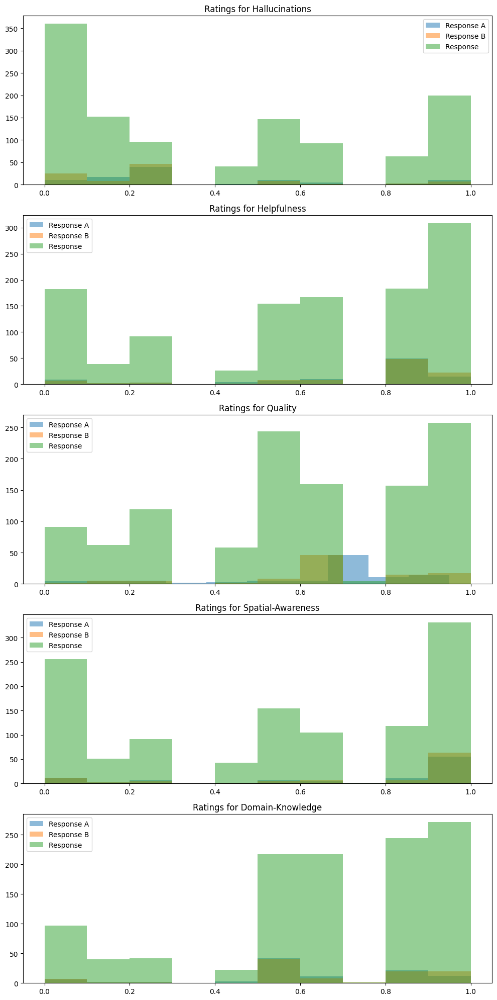

In [54]:
import matplotlib.pyplot as plt

attributes = ['Hallucinations', 'Helpfulness', 'Quality', 'Spatial-Awareness', 'Domain-Knowledge']

fig, axs = plt.subplots(len(attributes), figsize=(10, 20))

for i, attr in enumerate(attributes):
    axs[i].hist(new_attributes_0_100[f'RatingsforResponseA_{attr}'].dropna(), alpha=0.5, label='Response A')
    axs[i].hist(new_attributes_0_100[f'RatingsforResponseB_{attr}'].dropna(), alpha=0.5, label='Response B')
    axs[i].hist(new_attributes_0_1224[f'RatingsforResponseC_{attr}'].dropna(), alpha=0.5, label='Response ')
    axs[i].set_title(f'Ratings for {attr}')
    axs[i].legend()

plt.tight_layout()
plt.show()

There is no statistically significant difference between Response A and Response B.
Effect size (Cohen's d) between Response A and Response B: -0.14276824908598965
There is no statistically significant difference between Response B and Response C.
Effect size (Cohen's d) between Response B and Response C: -0.017111268570419422
There is no statistically significant difference between Response A and Response C.
Effect size (Cohen's d) between Response A and Response C: -0.1504056222398103
There is no statistically significant difference between Response A and Response B.
Effect size (Cohen's d) between Response A and Response B: -0.14276824908598965
There is no statistically significant difference between Response B and Response C.
Effect size (Cohen's d) between Response B and Response C: -0.017111268570419422
There is no statistically significant difference between Response A and Response C.
Effect size (Cohen's d) between Response A and Response C: -0.1504056222398103
There is no stat

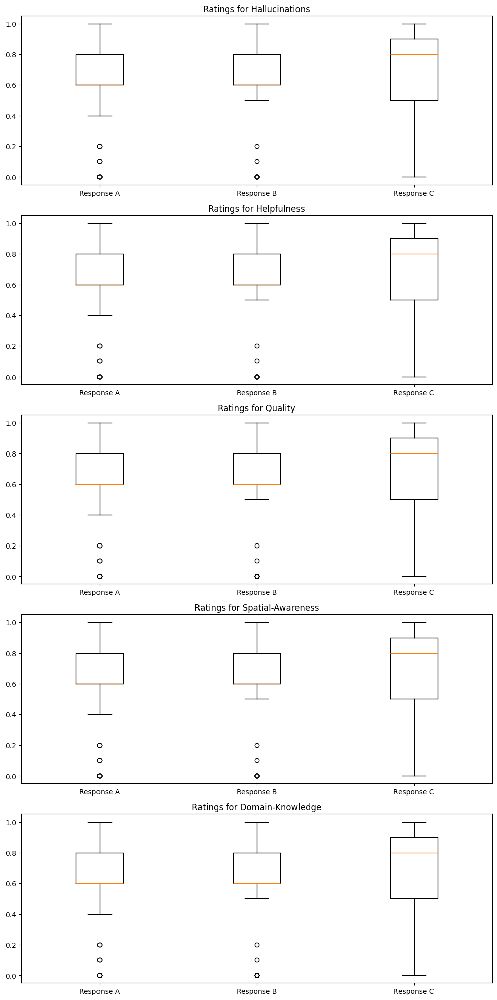

In [44]:
from scipy.stats import ttest_ind
import numpy as np
import matplotlib.pyplot as plt

attributes = ['Hallucinations', 'Helpfulness', 'Quality', 'Spatial-Awareness', 'Domain-Knowledge']

fig, axs = plt.subplots(len(attributes), figsize=(10, 20))

for i, attr in enumerate(attributes):

    # Perform t-test between Response A and Response B
    t_statistic, p_value = ttest_ind(data[0], data[1])

    # Calculate Cohen's d
    mean_diff = np.mean(data[0]) - np.mean(data[1])
    pooled_std = np.sqrt((np.std(data[0])**2 + np.std(data[1])**2) / 2)
    effect_size = mean_diff / pooled_std

    # Check if the p-value is less than the significance level (e.g., 0.05)
    if p_value < 0.05:
        print("There is a statistically significant difference between Response A and Response B.")
    else:
        print("There is no statistically significant difference between Response A and Response B.")
    print(f"Effect size (Cohen's d) between Response A and Response B: {effect_size}")

    # Perform t-test between Response B and Response C
    t_statistic, p_value = ttest_ind(data[1], data[2])

    # Calculate Cohen's d
    mean_diff = np.mean(data[1]) - np.mean(data[2])
    pooled_std = np.sqrt((np.std(data[1])**2 + np.std(data[2])**2) / 2)
    effect_size = mean_diff / pooled_std

    # Check if the p-value is less than the significance level (e.g., 0.05)
    if p_value < 0.05:
        print("There is a statistically significant difference between Response B and Response C.")
    else:
        print("There is no statistically significant difference between Response B and Response C.")
    print(f"Effect size (Cohen's d) between Response B and Response C: {effect_size}")

    # Perform t-test between Response A and Response C
    t_statistic, p_value = ttest_ind(data[0], data[2])

    # Calculate Cohen's d
    mean_diff = np.mean(data[0]) - np.mean(data[2])
    pooled_std = np.sqrt((np.std(data[0])**2 + np.std(data[2])**2) / 2)
    effect_size = mean_diff / pooled_std

    # Check if the p-value is less than the significance level (e.g., 0.05)
    if p_value < 0.05:
        print("There is a statistically significant difference between Response A and Response C.")
    else:
        print("There is no statistically significant difference between Response A and Response C.")
    print(f"Effect size (Cohen's d) between Response A and Response C: {effect_size}")

    axs[i].boxplot(data, labels=['Response A', 'Response B', 'Response C'])
    axs[i].set_title(f'Ratings for {attr}')
    
    # Add count, mean, and standard deviation in each boxplot
    for j, box in enumerate(axs[i].artists):
        # Get the data for the current box
        y = data[j]
        # Calculate count, mean, and standard deviation
        count = len(y)
        mean = y.mean()
        std = y.std()
        # Add the annotation to the boxplot
        axs[i].annotate(f'Count: {count}\nMean: {mean:.2f}\nStd: {std:.2f}', 
                        xy=(box.get_x() + box.get_width() / 2, mean),
                        xytext=(0, 10),
                        textcoords='offset points',
                        ha='center',
                        va='bottom')

plt.tight_layout()
plt.show()

In [43]:
new_attributes_0_1224.describe()

,id,preference,RatingsforResponseC_Hallucinations,RatingsforResponseC_Helpfulness,RatingsforResponseC_Quality,RatingsforResponseC_Spatial-Awareness,RatingsforResponseC_Domain-Knowledge,RatingsforResponseB_Hallucinations,RatingsforResponseB_Helpfulness,RatingsforResponseB_Quality,RatingsforResponseB_Spatial-Awareness,RatingsforResponseB_Domain-Knowledge
count,1151.000000,1151.000000,1151.000000,1151.000000,1151.000000,1150.000000,1151.000000,1151.000000,1151.000000,1151.000000,1150.000000,1151.000000
mean,284802.238923,1.489140,0.389183,0.580148,0.580886,0.527435,0.640704,0.302215,0.636751,0.643006,0.615870,0.667550
std,169461.913264,0.500099,0.377426,0.333367,0.292403,0.369551,0.282058,0.365016,0.334379,0.292420,0.375168,0.274354
min,1558.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,130595.500000,1.000000,0.000000,0.300000,0.400000,0.100000,0.500000,0.000000,0.400000,0.500000,0.300000,0.500000
50%,283170.000000,1.000000,0.300000,0.700000,0.700000,0.600000,0.700000,0.100000,0.800000,0.800000,0.800000,0.800000
75%,428436.500000,2.000000,0.700000,0.900000,0.800000,0.900000,0.800000,0.600000,0.900000,0.900000,0.900000,0.900000
max,581884.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [5]:
# For RatingsforResponseA
print(new_attributes['RatingsforResponseA_Hallucinations'].describe())
print(new_attributes['RatingsforResponseA_Helpfulness'].describe())
print(new_attributes['RatingsforResponseA_Quality'].describe())
print(new_attributes['RatingsforResponseA_Spatial-Awareness'].describe())
print(new_attributes['RatingsforResponseA_Domain-Knowledge'].describe())

# For RatingsforResponseB
print(new_attributes['RatingsforResponseB_Hallucinations'].describe())
print(new_attributes['RatingsforResponseB_Helpfulness'].describe())
print(new_attributes['RatingsforResponseB_Quality'].describe())
print(new_attributes['RatingsforResponseB_Spatial-Awareness'].describe())
print(new_attributes['RatingsforResponseB_Domain-Knowledge'].describe())

count    29.000000
mean      0.268966
std       0.315214
min       0.000000
25%       0.100000
50%       0.200000
75%       0.300000
max       1.000000
Name: RatingsforResponseA_Hallucinations, dtype: float64
count    29.000000
mean      0.720690
std       0.265087
min       0.000000
25%       0.700000
50%       0.800000
75%       0.900000
max       1.000000
Name: RatingsforResponseA_Helpfulness, dtype: float64
count    29.000000
mean      0.687931
std       0.260376
min       0.000000
25%       0.700000
50%       0.700000
75%       0.900000
max       0.950000
Name: RatingsforResponseA_Quality, dtype: float64
count    29.000000
mean      0.737931
std       0.301678
min       0.000000
25%       0.800000
50%       0.900000
75%       0.900000
max       1.000000
Name: RatingsforResponseA_Spatial-Awareness, dtype: float64
count    29.000000
mean      0.686207
std       0.192213
min       0.100000
25%       0.600000
50%       0.700000
75%       0.800000
max       1.000000
Name: RatingsforRes

In [3]:
new_attributes.to_csv('temp_0_30_resampled.csv')

,question_id,prompt,entire_prompt,answer_id,model_id,metadata,resample_answer,origional_llava_response,id,image,...,RatingsforResponseA_Hallucinations,RatingsforResponseA_Helpfulness,RatingsforResponseA_Quality,RatingsforResponseA_Spatial-Awareness,RatingsforResponseA_Domain-Knowledge,RatingsforResponseB_Hallucinations,RatingsforResponseB_Helpfulness,RatingsforResponseB_Quality,RatingsforResponseB_Spatial-Awareness,RatingsforResponseB_Domain-Knowledge
0,469170,\nWhat is this photo about'?\n,A chat between a curious user and an artificia...,ihY4X5x7h8b6UY8uUkn5cR,llava-v1.5-13b,{},The image depicts a group of three people gath...,"In the image, a group of young people sits aro...",469170,000000469170.jpg,...,0.2,0.8,0.70,0.9,0.6,0.2,0.8,0.70,0.9,0.6
1,466480,\n\nWhy might this boat have been left ashore?,A chat between a curious user and an artificia...,fGzPGpsNA3WH2hWnQtk3R9,llava-v1.5-13b,{},Based on the provided critique and the desired...,There could be several reasons why the old woo...,466480,000000466480.jpg,...,0.0,0.9,0.95,0.9,0.8,0.0,0.8,0.85,0.9,0.8
2,435347,\n\nWhat is the main focus of the image?,A chat between a curious user and an artificia...,5ZZSGdcarVdoKCMGW4bWow,llava-v1.5-13b,{},The main focus of the image is a man sitting a...,The main focus of the image is a woman sitting...,435347,000000435347.jpg,...,1.0,0.2,0.20,0.8,0.2,0.0,0.9,0.90,1.0,0.9
3,187213,\nWhat is the connection between the blue vase...,A chat between a curious user and an artificia...,fTP6qjqZ5eSpVi6CbpaUja,llava-v1.5-13b,{},The image features a blue vase filled with blu...,The connection between the blue vase with blue...,187213,000000187213.jpg,...,0.0,0.8,0.80,0.9,0.7,0.0,0.5,0.50,0.9,0.7
4,454181,\n\nWhat is this photo about'?,A chat between a curious user and an artificia...,h22YvaYSmiFT5yuvQW6jQ2,llava-v1.5-13b,{},Response A:\nThe image shows a group of people...,The image shows a room filled with students si...,454181,000000454181.jpg,...,0.2,0.8,0.70,0.9,0.6,0.2,0.8,0.70,0.9,0.6
5,377572,\nWrite a detailed description of the given im...,A chat between a curious user and an artificia...,3XxMjZwAykgzay4XNpTmKu,llava-v1.5-13b,{},Response A:\n\nThe image features a marina wit...,The image depicts a harbor alongside a river d...,377572,000000377572.jpg,...,0.2,0.8,0.70,0.9,0.6,0.2,0.8,0.70,0.9,0.6
6,292314,\nHow could you describe this boat's appearance?,A chat between a curious user and an artificia...,TFJAAADvFnguDBsv8B75q9,llava-v1.5-13b,{},"The boat is a colorful, old boat with a canopy...",The boat has an old and potentially dirty appe...,292314,000000292314.jpg,...,0.0,0.9,0.90,0.9,0.8,0.0,0.9,0.90,0.9,0.8
7,5508,\nWhat brings the group together in this scena...,A chat between a curious user and an artificia...,X6hwxKGUCjznCPCNtQvguo,llava-v1.5-13b,{},"In the image, a group of people is gathered in...",The group of people in the image has come toge...,5508,000000005508.jpg,...,0.1,0.9,0.90,0.9,0.7,0.0,0.0,0.00,0.0,0.0
8,82242,\nWhat impact does the scene have on overall t...,A chat between a curious user and an artificia...,fZm4QKZtPWWvtwsNR4JFUx,llava-v1.5-13b,{},The image depicts a busy city street filled wi...,The scene features a large number of buses on ...,82242,000000082242.jpg,...,0.0,0.8,0.80,0.8,0.7,0.0,0.5,0.50,0.8,0.7
9,130512,\nDescribe the following image.\n,A chat between a curious user and an artificia...,meEFy4kbocH2CNTwgK3FV4,llava-v1.5-13b,{},Response A:\nThe image shows a group of young ...,The image features a group of people gathered ...,130512,000000130512.jpg,...,0.1,0.9,0.90,0.9,0.9,0.1,0.9,0.90,0.9,0.9


In [13]:
data[0]['conversations'][-1]

{'from': 'gpt',
 'value': 'In the image, a group of young people sits around a dining table filled with various items. One person is cutting into a chocolate cake in the middle of the table, while others attentively look on. There are multiple cups and bowls placed around the table.\n\nThere is a total of six people sitting in the scene. To the left side of the table, there are two people facing the cake, and a third person is almost fully obscured behind them. On the right side, there are two more people sitting; one of them is cutting the cake. Lastly, there is another individual partially visible at the far end of the table.\n\nAlongside the cake, there are several bottles on the table, enriching the scene and possibly serving as refreshments for the gathering.'}

In [2]:
from step1gpt4v import *

load_dotenv()
global api_key
openai.api_key = os.environ.get('myother_openai_api')
api_key = openai.api_key
output_path = '/home/ubuntu/RLHF/LLaVA-RLHF/RLHF/gpt4_ratings/training_data/teacher-critique/gpt4_comparsion_between_resampled_and_ground_truth/llava-v1.5-13b-on-teacher-critique-0-2125.jsonl'
get_gpt4_comment(data, output_path, 0, 1, output_1_name='resample_answer', output_2_name='origional_llava_response')

100%|██████████| 1/1 [00:00<00:00, 2664.74it/s]

Error processing index 0: name 'api_key' is not defined


{}

In [14]:
def check_if_in_data_source(data_source, data):
    for i in range(len(data_source)):
        if data_source[i]['id'] == data[i]['question_id']:
            return True
    return False
check_if_in_data_source(data_source, data)

True

In [11]:
data[0].keys()

dict_keys(['question_id', 'prompt', 'entire_prompt', 'text', 'answer_id', 'model_id', 'metadata'])